In [152]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import pandas as pd
import scipy.io
import os
import csv
import utils
import pickle as pkl
import importlib
importlib.reload(utils)
%matplotlib inline

# Useful lambda functions

In [51]:
scatter3d = lambda ax, x, c='blue', marker='o': ax.scatter(x[:,0], x[:,1], x[:,2], c=c, marker=marker)
normalize = lambda x: (x-np.min(x))/(np.max(x)-np.min(x))

# DATA loading

## Important Paths

In [ ]:
gen_data_dir = "../gen_data/"
albert_path = '/Users/charliehuang/Documents/murthy_lab/projects/on_the_fly/albert_fdasynapses_copy/v783'
all_synaps_file = albert_path + '/all_syn/all_syn_34M_in_FDA.npy'

fru_fda_path = albert_path + '/fru_dsx/'
fru_boutons_file = 'fru_PRE_in_FDA.npy'
fru_dendrites_file = 'fru_POST_in_FDA.npy'

In [ ]:
## Loading in Fru from codex
synaps_codex_coords_file = gen_data_dir+'synapse_coordinates.csv'
fru_root_ids = list(pd.read_csv(gen_data_dir+'root_ids_gene_equal_Fruitless.txt').columns)
fru_set = set(fru_root_ids)
df = pd.read_csv(synaps_codex_coords_file, dtype={'pre_root_id': 'str', 'post_root_id': 'str'})
df_dendrites = df[df['post_root_id'].notna()]
df_boutons = df[df['pre_root_id'].notna()]

print(df_dendrites.shape, df_boutons.shape )
print("why so many more dendrites marked than boutons?")
print('i understand it now')

fru_dendr = df_dendrites[df_dendrites['post_root_id'].isin(fru_set)]
fru_bout = df_boutons[df_boutons['pre_root_id'].isin(fru_set)]

print(fru_dendr.shape)
print(fru_bout.shape)

(2701274, 5) (129360, 5)
why so many more dendrites marked than boutons?
(33030, 5)
(1314, 5)


## Load in FDA coords

In [ ]:
fru_boutons = np.load(fru_fda_path + fru_boutons_file)
fru_dendrites = np.load(fru_fda_path + fru_dendrites_file)
all_synaps = np.load(all_synaps_file)

fda_fru_ids = pd.read_csv(fru_fda_path + 'fru_783.txt').columns

## Loading in Codex Synapses

In [5]:
scsv_path = '/Users/charliehuang/Documents/murthy_lab/projects/on_the_fly/albert_fdasynapses_copy/v783/all_syn/synapse_coordinates_from_codex.csv'
synaps_csv = pd.read_csv(scsv_path, dtype={'pre_root_id': 'str', 'post_root_id': 'str'})

## Load in LC10 IDs

In [10]:
alphabet = ['a','b','c','d']
lc10_names = [f'root_ids_cell_type_equal_LC10{letter}.txt' for letter in alphabet]
dict_lc10_root_ids = {}
for nam,letter in zip(lc10_names, alphabet):    
    root_ids = list(pd.read_csv(gen_data_dir+nam).columns)
    dict_lc10_root_ids[f'{letter}'] = root_ids
counter = 0

## Note: the other LCs are not fru+
# lcs_list = []
# for key in dict_lc10_root_ids.keys():
#     lc_ids = []
#     print(key + ' *****')
#     root_ids = dict_lc10_root_ids[key]
#     for ri in root_ids:
#         if ri not in fru_set:
#             counter += 1
#             print(ri)
#         else:
#             lc_ids.append(ri)
#     print(f'LC10_ not in fru set #: {counter}')
#     lcs_list.append(lc_ids)

In [4]:
class Neuron:
    def __init__(self, root_id):
        self.root_id = root_id
        self.dendrites = np.array([])
        self.boutons = np.array([])
        self.row_id_dends = None
        self.row_id_boutons = None
    def add_dendrite(self, dend_coords, upstream_boutons, rowbounds): #post synapse
        # assert type(dend_coords) == list
        self.dendrites = dend_coords
        self.row_id_dends = rowbounds
        self.upstream_boutons  = upstream_boutons
    def add_bouton(self, bouton_coords, downstream_dendrites, rowbounds):
        # assert type(bouton_coords) == list
        self.boutons = bouton_coords
        self.row_id_boutons = rowbounds
        self.downstream_dendrites = downstream_dendrites
    def count_processes(self):
        print('num dendrites: ', len(self.dendrites))
        print('num boutons: ', len(self.boutons))    
        
def slice_synapses(df, col, val):
    start_values = df[col][~pd.isnull(df[col])]
    start_idxs, = np.where(start_values.values == val)
    sliced = []
    for start_idx in start_idxs:
        try:
            sliced.append(df.loc[start_values.index[start_idx]:start_values.index[start_idx + 1] - 1])
        except IndexError:
            sliced.append(df.loc[start_values.index[start_idx]:])
    return pd.concat(sliced)

In [89]:
counter = 0
neuron_list = []
for root_id in dict_lc10_root_ids['a']:
    new_neuron = Neuron(root_id)
    dend_df = slice_synapses(synaps_csv, 'post_root_id', root_id)
    upstream_boutons = list(dend_df['pre_root_id'])
    dend_mats = dend_df[['x','y','z']].to_numpy()
    new_neuron.add_dendrite(dend_mats, upstream_boutons, list(dend_df.index))
    del dend_df
    bout_df = slice_synapses(synaps_csv, 'pre_root_id', root_id)
    bout_mats = bout_df[['x','y','z']].to_numpy()
    downstream_dendrites = list(bout_df.index)
    new_neuron.add_bouton(bout_mats, downstream_dendrites, list(bout_df.index))
    del bout_df
    neuron_list.append(new_neuron)

In [91]:
lc10a_filename = gen_data_dir + 'lc10a_neuron_objects.pkl'
# Save the object to the file
with open(lc10a_filename, 'wb') as file:
    pkl.dump(neuron_list, file)

In [5]:
lc10a_filename = gen_data_dir + 'lc10a_neuron_objects.pkl'
with open(lc10a_filename, 'rb') as file:
    neuron_list = pkl.load(file)

In [ ]:
dendr_df = synaps_csv[synaps_csv['post_root_id'].notna()]
bouton_df = synaps_csv[synaps_csv['pre_root_id'].notna()]

def find_csv_subset(df, root_ids, id_use='post_root_id'):
    root_set = set(root_ids)
    return df[df[id_use].isin(root_set)]
lc10_dict = {}

for key,letter in zip(dict_lc10_root_ids, alphabet):
    print(key)
    lc10_list = dict_lc10_root_ids[key]
    lc10_dendrites = find_csv_subset(dendr_df, lc10_list, id_use='post_root_id')
    lc10_boutons = find_csv_subset(bouton_df, lc10_list, id_use='pre_root_id')
    lc10_dict[letter] = [lc10_dendrites, lc10_boutons]

lc10_a_root_ids
lc10_b_root_ids
lc10_c_root_ids
lc10_d_root_ids


# LC10a plotting + simulation

In [94]:
for elem in dir(neuron_list[0]):
    if elem.startswith('__'):
        continue
    print(elem)

add_bouton
add_dendrite
boutons
count_processes
dendrites
downstream_dendrites
root_id
row_id_boutons
row_id_dends
upstream_boutons


In [194]:
import random
def generate_random_rgb():
  """Generates a random RGB color tuple."""
  r = random.random()
  g = random.random()
  b = random.random()
  return (r, g, b)

left_eye_threshold = 500000
lobula_threshold = 140000

lc10a_neurdict = {}
for i in range(len(neuron_list)):
    output_dict = {}
    output_dict['dendrites'] = neuron_list[i].dendrites
    output_dict['boutons'] = neuron_list[i].boutons
    output_dict['mean_dendrite'] = np.mean(neuron_list[i].dendrites, axis=0) 
    output_dict['median_dendrite'] = np.median(neuron_list[i].dendrites, axis=0)

    output_dict['mean_bouton'] = np.mean(neuron_list[i].boutons, axis=0)
    output_dict['median_bouton'] = np.median(neuron_list[i].boutons, axis=0)

    if output_dict['mean_dendrite'][0] <= left_eye_threshold: #we know lc10as do NOT go across hemisphere        
        output_dict['left_flag'] = True
    else:
        output_dict['left_flag'] = False
    output_dict['dend_lobula_flag'] = output_dict['mean_dendrite'][2] >= lobula_threshold
    output_dict['bouton_lobula_flag'] = output_dict['mean_bouton'][2] >= lobula_threshold
    output_dict['color'] = generate_random_rgb()
    lc10a_neurdict[neuron_list[i].root_id] = output_dict
    
def assign_colors(neurdict, left_flag, mode='left_to_right'):
    relev_vals = []
    corresp_keys = []
    for i,key in enumerate(neurdict.keys()):
        output_dict = neurdict[key]
        if mode == 'left_to_right':
            if output_dict['left_flag'] == left_flag:
                corresp_keys.append(key)
                relev_vals.append(output_dict['mean_dendrite'][0]) #color by mean dendrite x position
        else:
            print("Not supported yet")
            break     
    colors = normalize(relev_vals)
    return corresp_keys, colors


def assign_colors_classifier(neurdict, loc_classifier, color_axis=0, left_flag=True):
    relev_vals = []
    corresp_keys = []
    for i,key in enumerate(neurdict.keys()):
        output_dict = neurdict[key]
        if output_dict['left_flag'] == left_flag:
            median_dendrite = output_dict['median_dendrite']
            zeta = np.expand_dims(median_dendrite, axis=1).T
            lobula_prediction = kmeans.predict(zeta)[0]
            if lobula_prediction:
                corresp_keys.append(key)
                relev_vals.append(median_dendrite[color_axis]) #color by mean dendrite x position
    colors = normalize(relev_vals)
    return corresp_keys, colors

In [ ]:
left_keys, left_colors = assign_colors(lc10a_neurdict, True) #Assigning off of mean neuron (yes for left)
print(len(left_keys))
right_keys, right_colors = assign_colors(lc10a_neurdict, False) #Assigning off of mean neuron (yes for right)
print(len(right_keys))

116
121


In [124]:
def prep_plotly_arrs(neuronlist_dict, key_list, color_list, mode='all', cmap='cool'):
    assert mode == 'all', "not accepted yet"
    cmap = cm.get_cmap(cmap)
    norm = mcolors.Normalize(vmin=0, vmax=1)
    colors = [cmap(norm(val)) for val in color_list]
    dendrites_stack = []
    boutons_stack = []
    color_list_dends, color_list_boutons = [], []
    for i,neuron_id in enumerate(key_list):
        neurdict = neuronlist_dict[neuron_id]
        dcoords = neurdict['dendrites']
        bcoords = neurdict['boutons']
        dendrites_stack.append(dcoords)
        boutons_stack.append(bcoords)
        color_list_dends += [color_list[i]]*dcoords.shape[0]
        color_list_boutons += [color_list[i]]*bcoords.shape[0]
    dendrites_stack = np.vstack(dendrites_stack)
    boutons_stack = np.vstack(boutons_stack)
    # dends_color_list_full = np.hstack(color_list_dends)
    # boutons_color_list_full = np.hstack(color_list_boutons)
    output_dict = {'dendrites_stack': dendrites_stack, 'boutons_stack': boutons_stack,
                   'color_list_dends': color_list_dends, 'color_list_boutons': color_list_boutons}
    return output_dict

def plot_neurlist_dict(neuronlist_dict, key_list, color_list, z_plane=100000, cmap = 'cool', title='LC10a', mode='mean'):
    fig = plt.figure(figsize=(15, 8))
    ax = fig.add_subplot(111, projection='3d')
    cmap = cm.get_cmap(cmap)
    norm = mcolors.Normalize(vmin=0, vmax=1)
    colors = [cmap(norm(val)) for val in color_list]
    
    dcoord_list, bcoord_list = [],[]
    lobula_processes, aotu_processes = [],[]
    lobula_identities, aotu_identities = [], []
    for i,neuron_id in enumerate(key_list):
        neurdict = neuronlist_dict[neuron_id]
        if mode == 'all':
            dcoords = neurdict['dendrites']
            bcoords = neurdict['boutons']
            ax.scatter(dcoords[:,0], dcoords[:,1], dcoords[:,2], c=colors[i], marker='v')
            ax.scatter(bcoords[:,0], bcoords[:,1], bcoords[:,2], c=colors[i], marker='o')    
        else:
            if mode == 'mean':
                dcoords = neurdict['mean_dendrite']
                bcoords = neurdict['mean_bouton']  
            elif mode == 'median':
                dcoords = neurdict['median_dendrite']
                bcoords = neurdict['median_bouton']  
            else:
                print('MODE NOT ACCEPTED')
                break
            lines = np.vstack([dcoords, bcoords])
            ax.scatter(dcoords[0], dcoords[1], dcoords[2], c=colors[i], marker='v')
            ax.scatter(bcoords[0], bcoords[1], bcoords[2], c=colors[i], marker='o')
            ax.plot(lines[:,0], lines[:,1], lines[:,2], c='0.5', alpha=0.5)
        
        if neurdict['dend_lobula_flag']:
            lobula_processes.append(dcoords)
            lobula_identities.append('d')
        else:
            aotu_processes.append(dcoords)
            aotu_identities.append('d')
        if neurdict['bouton_lobula_flag']:
            lobula_processes.append(bcoords)
            lobula_identities.append('b')
        else:
            aotu_processes.append(bcoords)
            aotu_identities.append('b')
    fig.suptitle(title)
    output_dict = {'dcoord_list': np.array(dcoord_list), 'bcoord_list': np.array(bcoord_list),
                   'lobula_processes': np.array(lobula_processes), 'aotu_processes': np.array(aotu_processes),
                   'lobula_identities': lobula_identities, 'aotu_identities': aotu_identities}
    return output_dict

In [ ]:
left_full_synaps_dict = prep_plotly_arrs(lc10a_neurdict, left_keys, left_colors, mode = 'all')
fullstack = np.vstack([left_full_synaps_dict['dendrites_stack'], left_full_synaps_dict['boutons_stack']])


from sklearn.cluster import KMeans

# Initialize KMeans with the desired number of clusters
n_clusters = 2
kmeans = KMeans(n_clusters=n_clusters, random_state=random_state, n_init=10)

# Fit the model to the data
kmeans.fit(fullstack)

# Get the cluster assignments and cluster centers
cluster_labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_

utils.interactive_plot(fullstack[:,0], fullstack[:,1], fullstack[:,2], color_list=cluster_labels.astype(int))

/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/1220200920.py:3: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



In [199]:
left_keys, left_colors = assign_colors_classifier(lc10a_neurdict, kmeans, color_axis=0, left_flag=True)

In [ ]:
arr_oi = left_synaps_dict_dendslobula['dendrites_stack']


print(arr_oi.shape)
print(sum(mask))
arr_oi[mask].shape

(6922, 3)
4215


(4215, 3)

array([0.29668723, 0.29668723, 0.29668723, ..., 0.44876941, 0.44876941,
       0.44876941], shape=(4215,))

In [222]:
left_synaps_dict_dendslobula = prep_plotly_arrs(lc10a_neurdict, left_keys, left_colors, mode = 'all')
fullstack_dendslobula = np.vstack([left_synaps_dict_dendslobula['dendrites_stack'], left_synaps_dict_dendslobula['boutons_stack']])
dends_stack = left_synaps_dict_dendslobula['dendrites_stack']
mask = kmeans.predict(dends_stack).astype(bool)
dends_stack = dends_stack[mask]
resp_colors = np.array(left_synaps_dict_dendslobula['color_list_dends'])[mask]
fig = utils.interactive_plot(dends_stack[:,0], dends_stack[:,1], dends_stack[:,2], color_list=resp_colors, title='Left eye - LC10a projections Lobula to AOTU')

boutons_stack = left_synaps_dict_dendslobula['boutons_stack']
bmask = kmeans.predict(boutons_stack).astype(bool)
boutons_stack = boutons_stack[~bmask]
resp_colors = np.array(left_synaps_dict_dendslobula['color_list_boutons'])[~bmask]

fig = utils.add_to_plot(fig, boutons_stack[:,0], boutons_stack[:,1], boutons_stack[:,2], color_list=resp_colors)

fig.show()

/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/1220200920.py:3: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



In [197]:
# prep_plotly_arrs(neuronlist_dict, key_list, color_list, mode='all'):
arr_oi = left_full_synaps_dict['dendrites_stack']
utils.interactive_plot(arr_oi[:,0], arr_oi[:,1], arr_oi[:,2], color_list=left_full_synaps_dict['color_list_dends'])

In [226]:
sum(kmeans.predict(left_full_synaps_dict['dendrites_stack']))/len(kmeans.predict(left_full_synaps_dict['dendrites_stack']))

np.float64(0.4793521183321063)

In [ ]:
arr_oi = left_full_synaps_dict['boutons_stack']
utils.interactive_plot(arr_oi[:,0], arr_oi[:,1], arr_oi[:,2], color_list=left_full_synaps_dict['color_list_boutons'])

/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/1220200920.py:3: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



In [227]:
sum(kmeans.predict(left_full_synaps_dict['boutons_stack']))/len(kmeans.predict(left_full_synaps_dict['boutons_stack']))

np.float64(0.02402225879771142)

In [ ]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

# Generate sample data
n_samples = 300
random_state = 42
X, y = make_blobs(n_samples=n_samples, centers=4, random_state=random_state)

# Initialize KMeans with the desired number of clusters
n_clusters = 3
kmeans = KMeans(n_clusters=2, random_state=random_state, n_init=10)

# Fit the model to the data
kmeans.fit(X)

# Get the cluster assignments and cluster centers
cluster_labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(X[:, 0], X[:, 1], c=cluster_labels, cmap='viridis', s=50, alpha=0.8)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('K-Means Clustering')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.legend()
plt.grid(True)
plt.show()

dict_keys(['dendrites_stack', 'boutons_stack', 'color_list_dends', 'color_list_boutons'])

/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/3152653338.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap)
/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/3152653338.py:29: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(dcoords[0], dcoords[1], dcoords[2], c=colors[i], marker='v')
/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/3152653338.py:30: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided

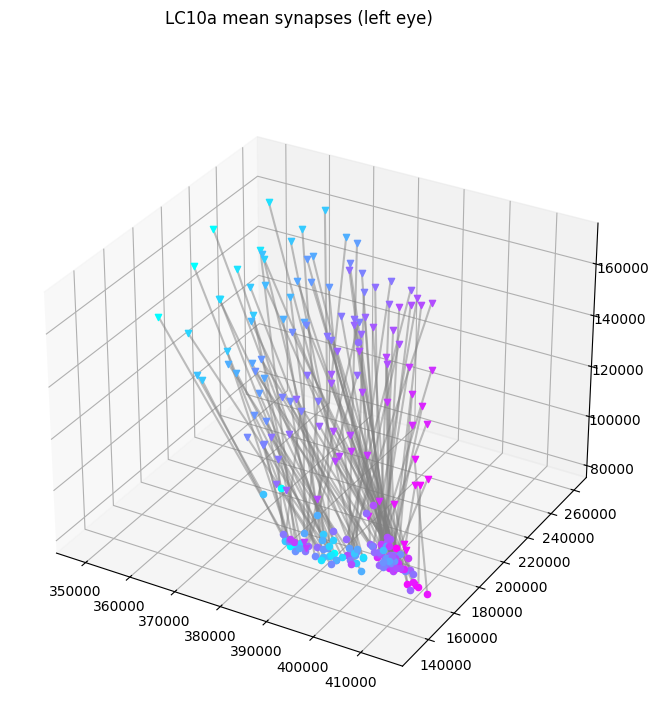

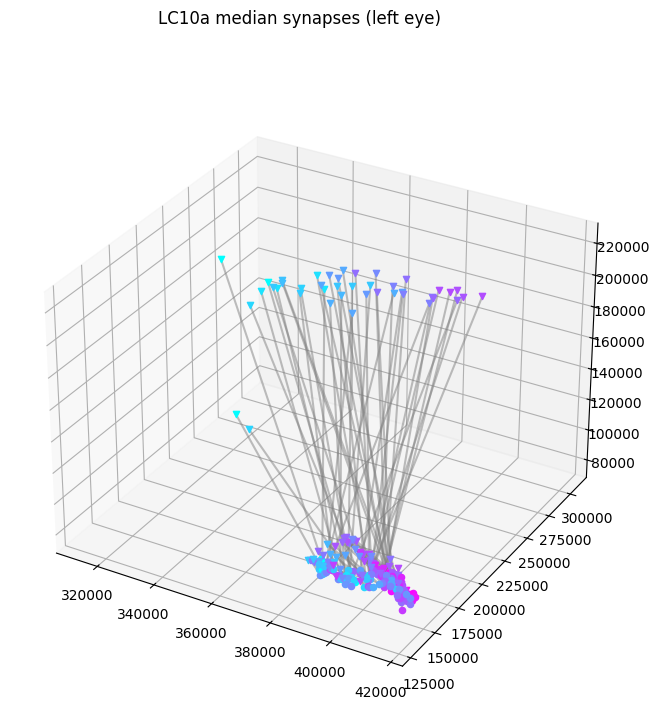

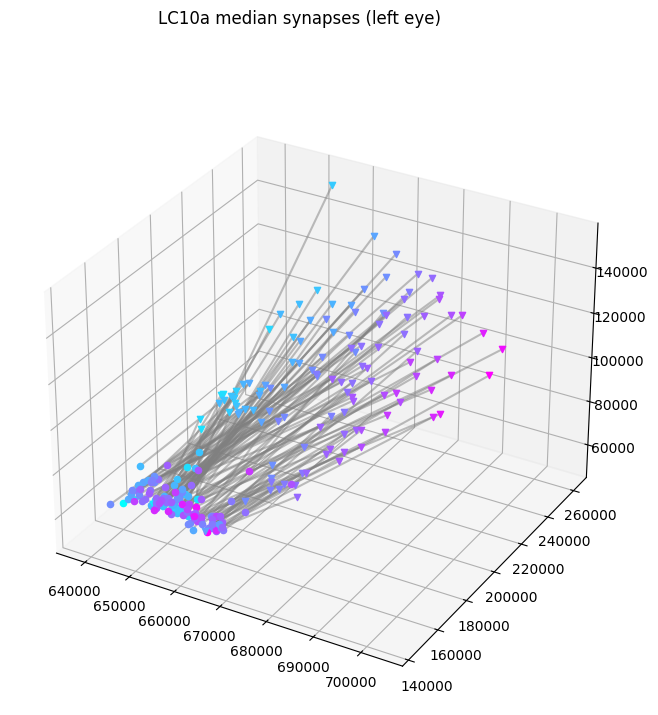

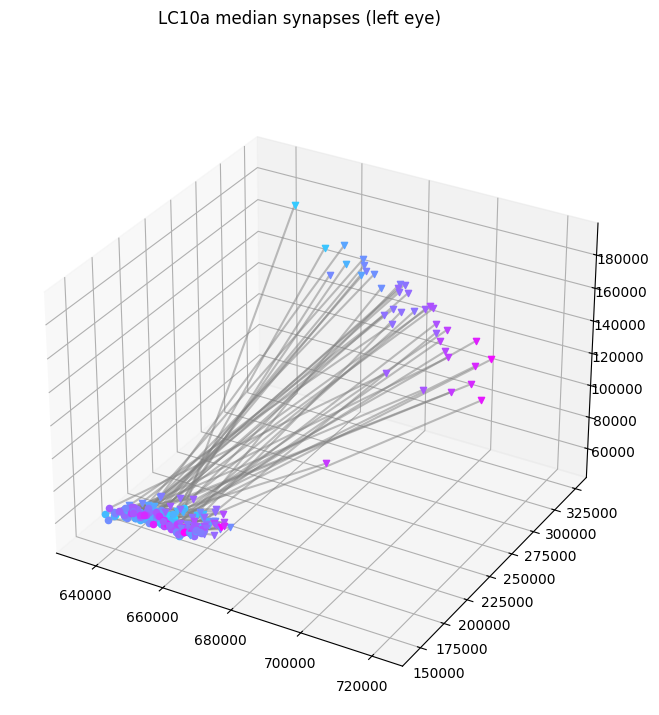

In [98]:
left_parse_dict_mean = plot_neurlist_dict(lc10a_neurdict, left_keys, left_colors, title='LC10a mean synapses (left eye)', mode='mean')
left_parse_dict_med = plot_neurlist_dict(lc10a_neurdict, left_keys, left_colors, title='LC10a median synapses (left eye)', mode='median')
right_parse_dict_mean = plot_neurlist_dict(lc10a_neurdict, right_keys, right_colors, title='LC10a median synapses (left eye)', mode='mean')
right_parse_dict_med = plot_neurlist_dict(lc10a_neurdict, right_keys, right_colors, title='LC10a median synapses (left eye)', mode='median')

/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/2489399536.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap)
/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/2489399536.py:29: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(dcoords[0], dcoords[1], dcoords[2], c=colors[i], marker='v')
/var/folders/6z/nhjp1qw15ksfthlqr8sbx68r0000gn/T/ipykernel_34644/2489399536.py:30: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided

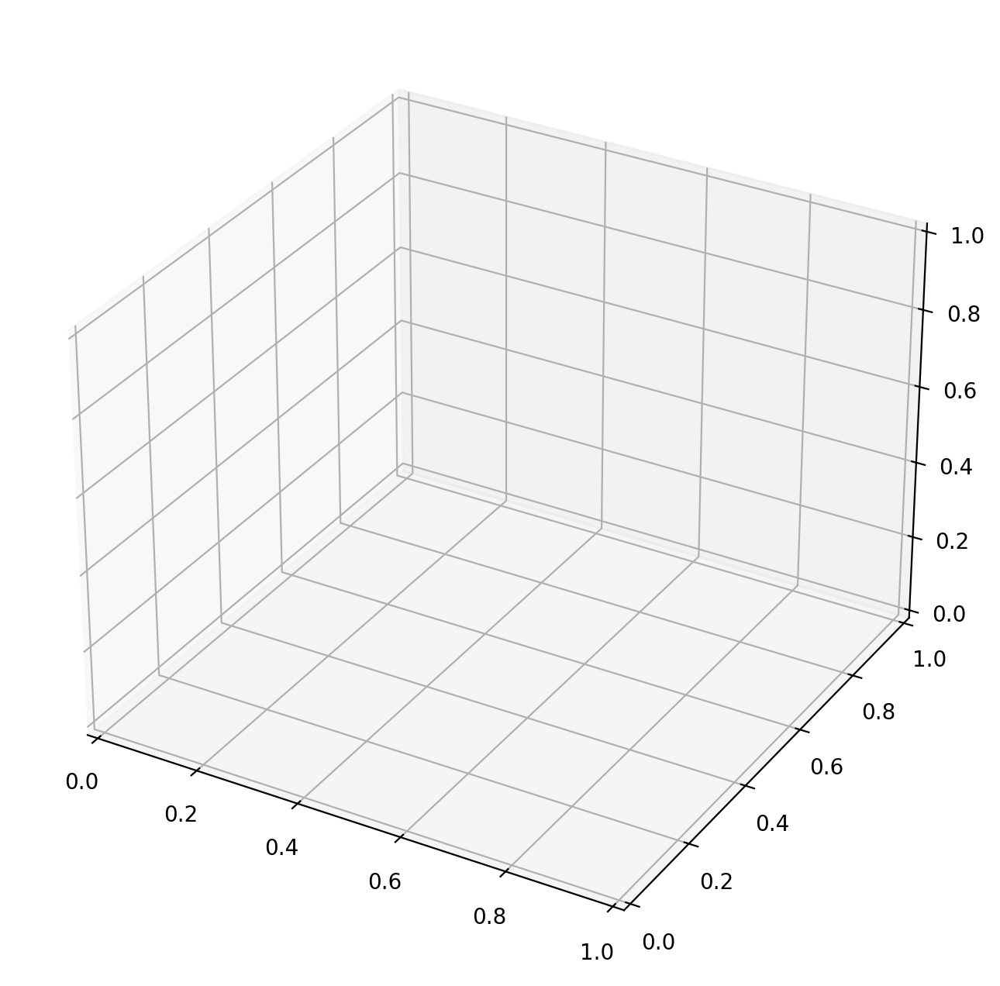

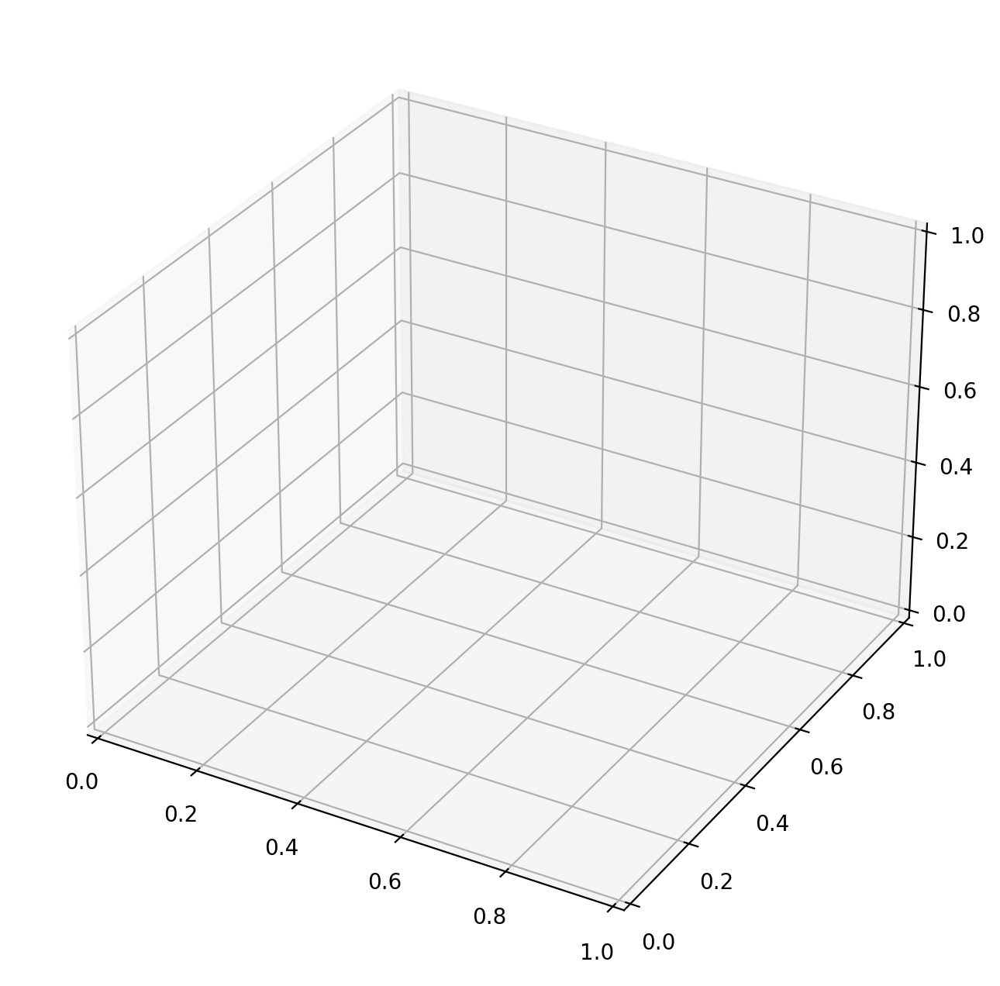

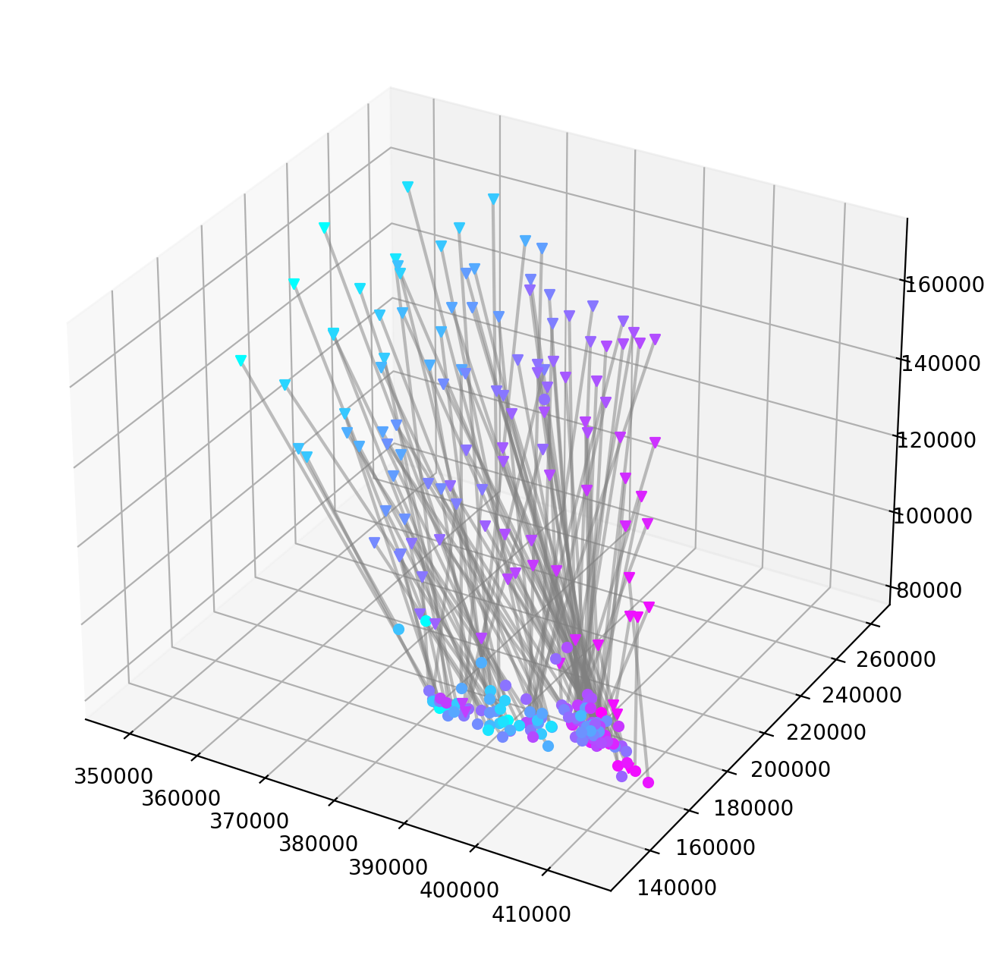

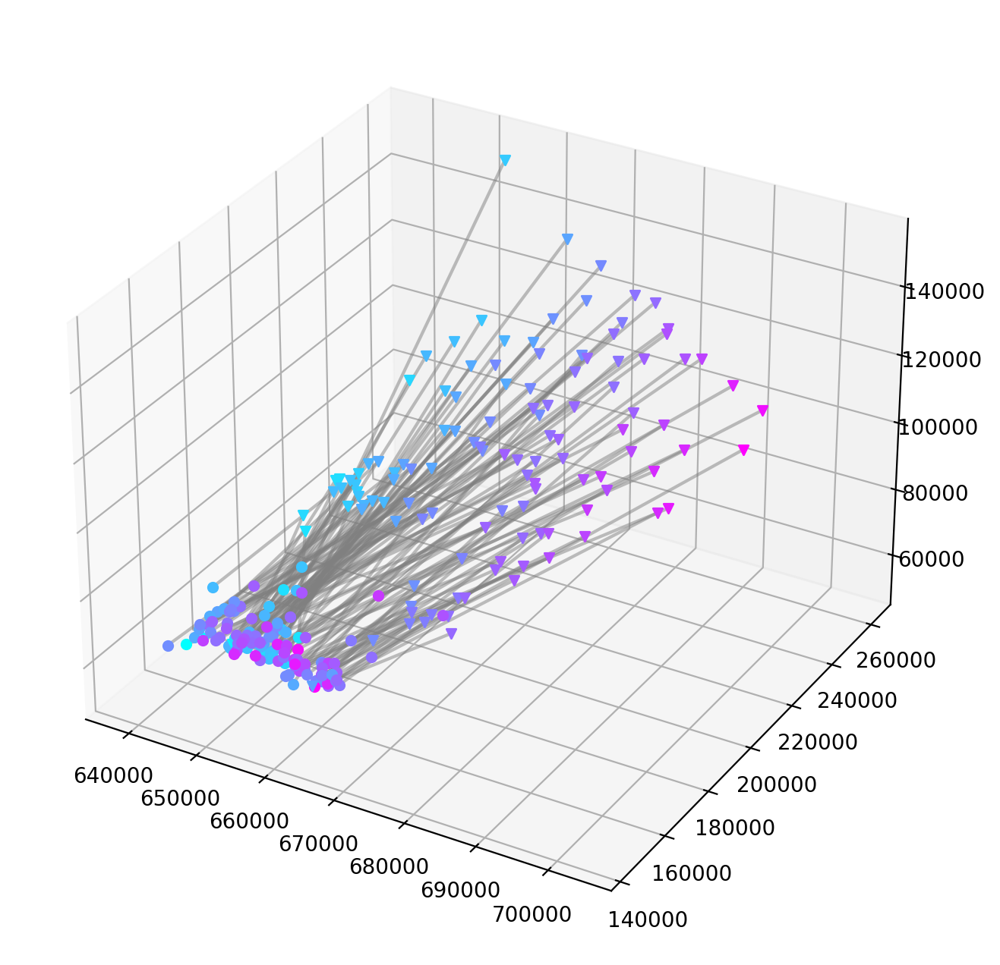

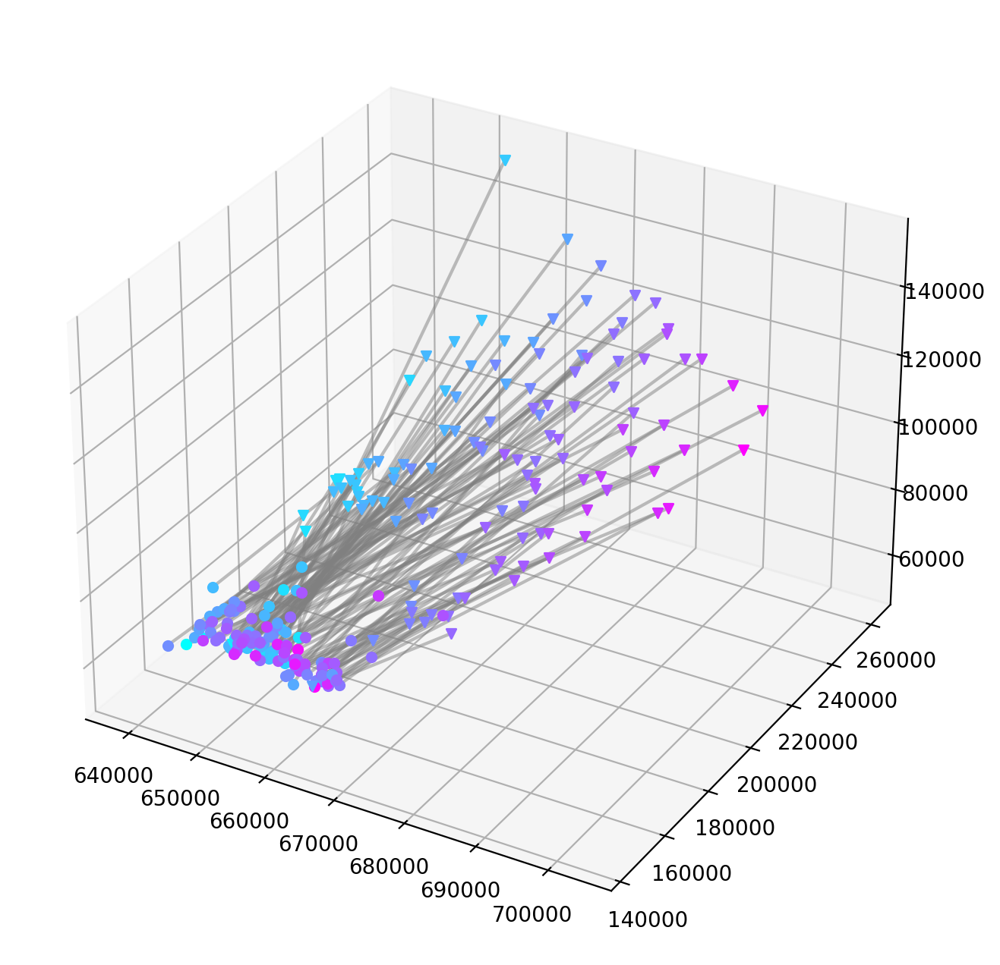

...

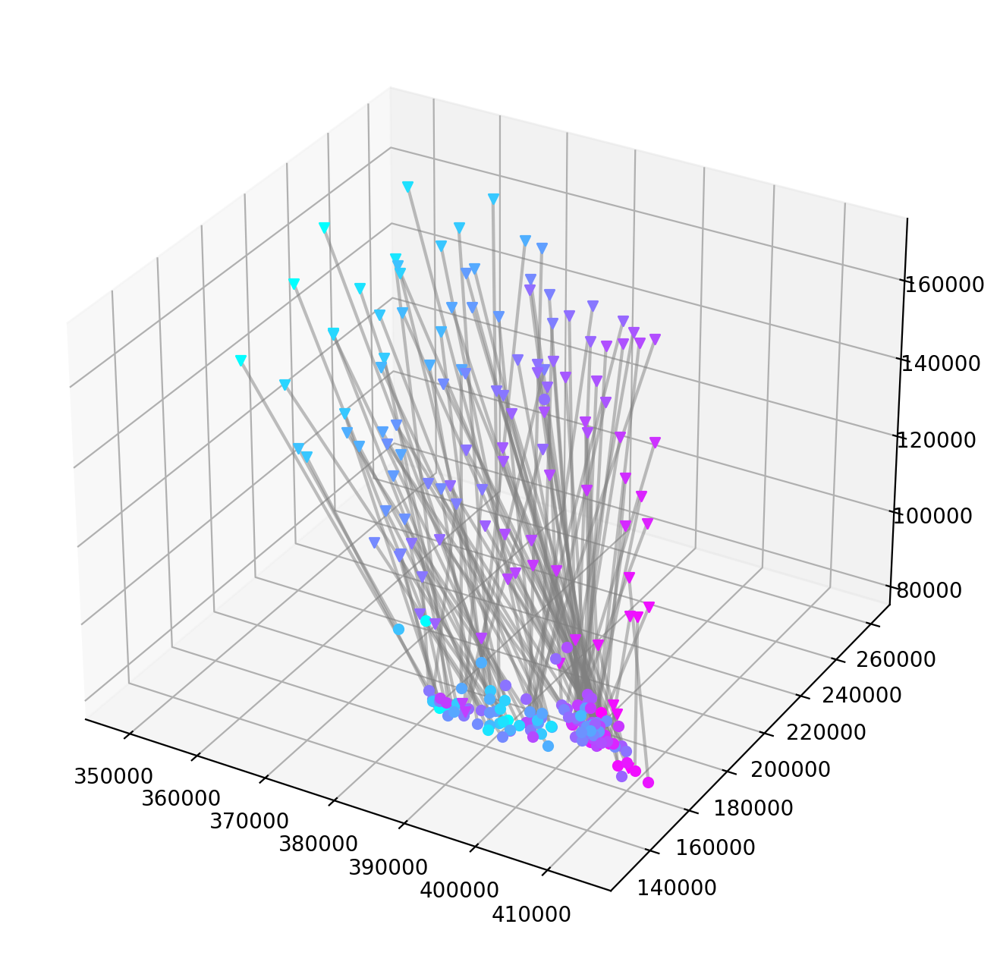

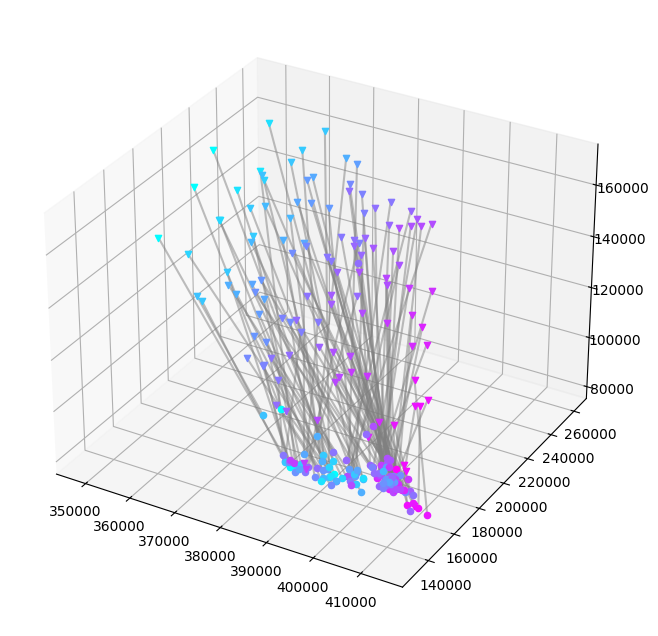

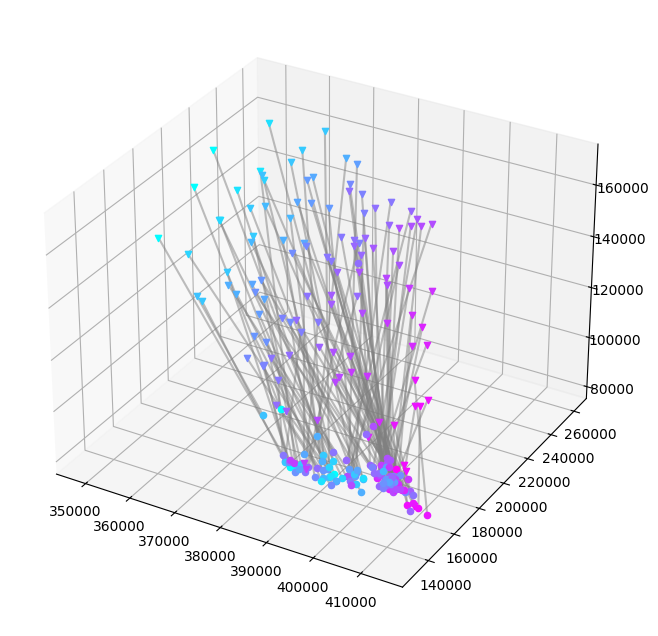

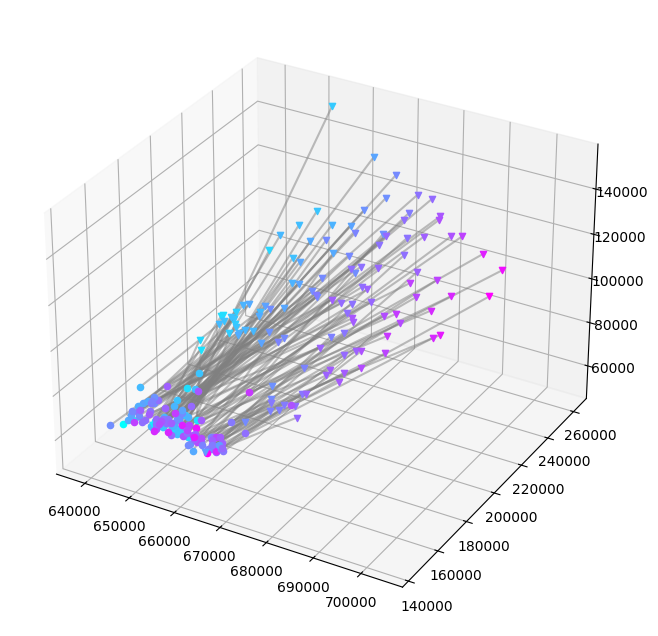

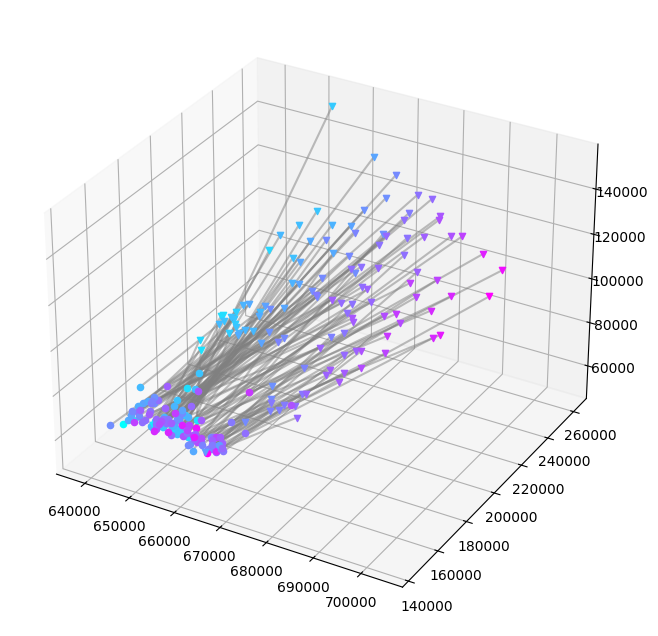

In [ ]:

left_parse_dict_mean = plot_neurlist_dict(lc10a_neurdict, left_keys, left_colors, mode='mean')
left_parse_dict_med = plot_neurlist_dict(lc10a_neurdict, left_keys, left_colors, mode='median')


In [ ]:
%matplotlib widget 
from mpl_toolkits.mplot3d import Axes3D 
fig = plt.figure() 
ax = Axes3D(fig) 
arr_oi = left_parse_dict['lobula_processes']
plot_geeks = ax.scatter(arr_oi[:,0], arr_oi[:,1], arr_oi, color='green') 
  
# setting title and labels 
ax.set_title("lobula, AOTU, and other") 
ax.set_xlabel('x-axis') 
ax.set_ylabel('y-axis') 
ax.set_zlabel('z-axis') 
  
# displaying the plot 
plt.show() 

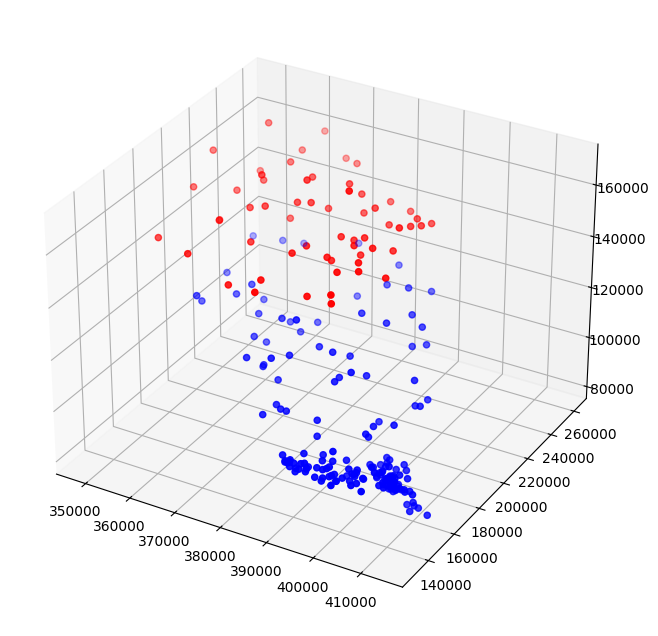

In [70]:
fig = plt.figure(figsize=(15, 8))
ax = fig.add_subplot(111, projection='3d')
scatter3d(ax, left_parse_dict['lobula_processes'], c='r')
scatter3d(ax, left_parse_dict['aotu_processes'], c='b')
# plt.hist(left_parse_dict['aotu_processes'][:,2], alpha=0.4)

TypeError: Axis.get_gridlines() takes 1 positional argument but 2 were given

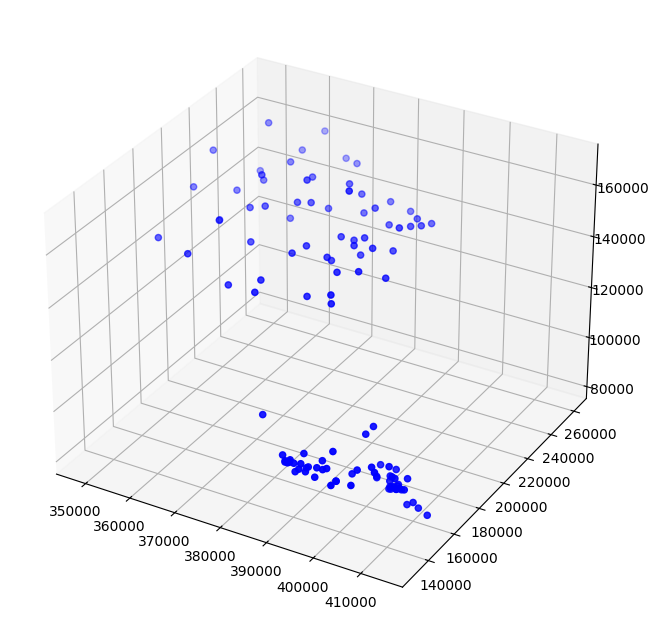

In [ ]:
left_parse_dict['lobula_arr'].shape, left_parse_dict['aotu_arr'].shape

fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection='3d')


# zetaplot(left_parse_dict['aot
# u_arr'], 'r', ax)
zetaplot(left_parse_dict['lobula_arr'], 'b', ax)


In [131]:
d.shape

(121, 3)

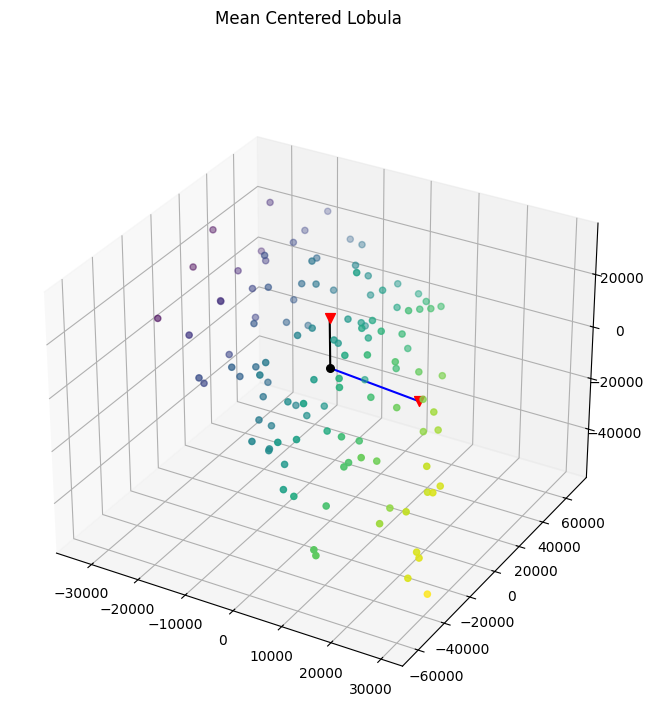

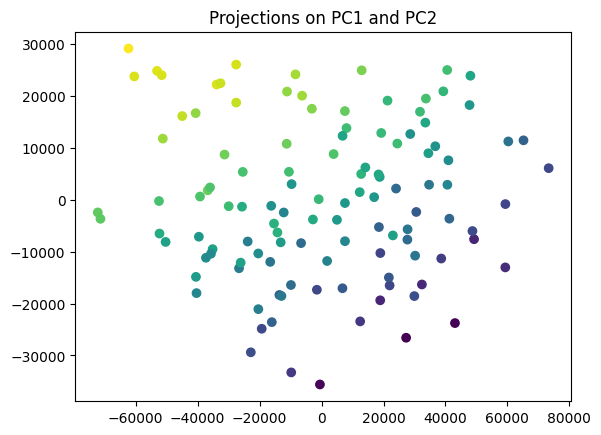

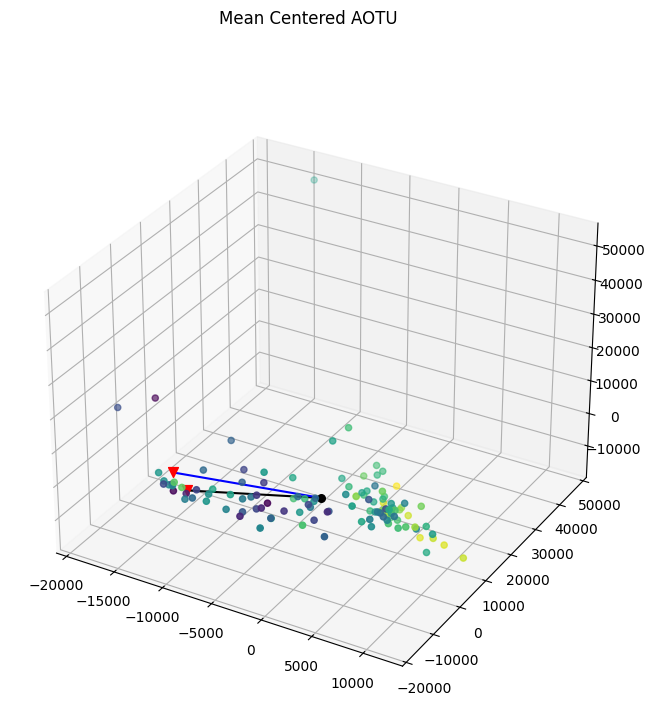

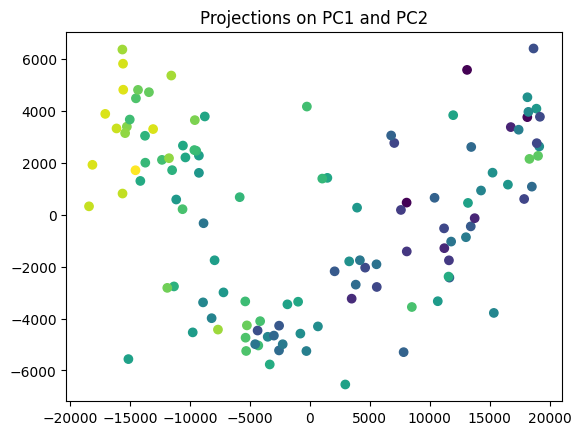

In [134]:
# lobula_np = np.array(lobula_points).astype(float)
# aotu_np = np.array(aotu_points).astype(float)


# def plot_neurlist_dict(neuronlist_dict, key_list, color_list, z_plane=100000, cmap = 'cool', title='LC10a'):

def plot_pc2_projections(arr, title='', color_list=None, eigs_use=[0,1]):
    avg_arr = np.mean(arr, axis=0)
    arr_mean_ctrd = arr-avg_arr
    cov_mat = np.cov(arr_mean_ctrd.T)
    eigenvalues, vl, vr = scipy.linalg.eig(cov_mat, left=True, right=True)

    fig = plt.figure(figsize=(8, 8))
    fig.suptitle('Mean Centered ' + title)
    ax = fig.add_subplot(111, projection='3d')
    if color_list is not None:
        ax.scatter(arr_mean_ctrd[:,0], arr_mean_ctrd[:,1], arr_mean_ctrd[:,2], c=color_list)
    else:
        ax.scatter(arr_mean_ctrd[:,0], arr_mean_ctrd[:,1], arr_mean_ctrd[:,2], c=color_list)
    ax.scatter(0,0,0, c='0', s=30)
    pc1_plot = vr[:,eigs_use[0]]*20000
    pc2_plot = vr[:,eigs_use[1]]*20000
    ax.scatter(pc1_plot[0], pc1_plot[1], pc1_plot[2], c='r', s=50, marker='v')
    ax.plot([0,pc1_plot[0]], [0,pc1_plot[1]], [0,pc1_plot[2]], c='0')
    ax.scatter(pc2_plot[0], pc2_plot[1], pc2_plot[2], c='r', s=50, marker='v')
    ax.plot([0,pc2_plot[0]], [0,pc2_plot[1]], [0,pc2_plot[2]], c='b')

    projections = arr_mean_ctrd @ vr[:,eigs_use]

    plt.figure()
    if color_list is not None:
        plt.scatter(projections[:,0], projections[:,1], c=color_list)
    else:
        plt.scatter(projections[:,0], projections[:,1], c=color_list)
    plt.title('Projections on PC1 and PC2')
    return eigenvalues, vl, vr
    
lob_eig, lob_vl, lob_vr = plot_pc2_projections(a, title='Lobula', color_list=left_colors, eigs_use=[0,1])
aot_eig, aot_vl, aot_vr = plot_pc2_projections(b, title='AOTU', color_list=left_colors, eigs_use=[0,1])

In [442]:

e, vl, vr = scipy.linalg.eig(np.cov(np.random.random([30,8]).T), right=True, left=True)

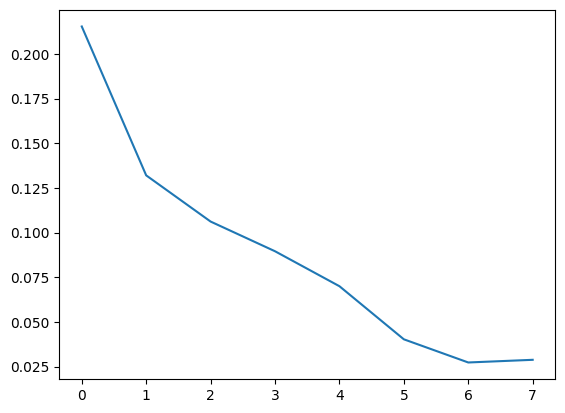

In [443]:
plt.plot(e)

(0.0, 1.0)

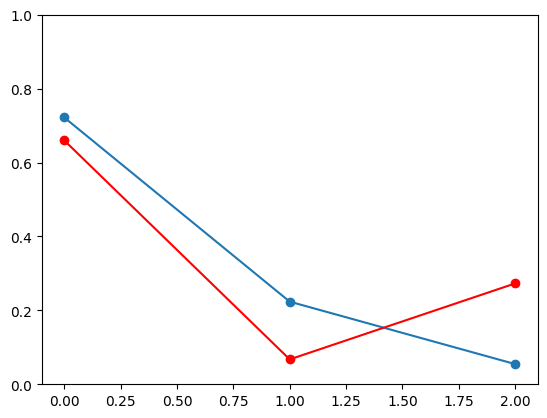

In [437]:
lob_eig = lob_eig/np.sum(lob_eig)
aot_eig = aot_eig/np.sum(aot_eig)
plt.plot(lob_eig, '-o')
plt.plot(aot_eig, '-o', c='r')
plt.ylim([0,1])


In [169]:
# Convert DataFrames to NumPy arrays
lc10a_dendr_np = lc10a_dendrites[['x', 'y', 'z']].to_numpy()
lc10a_bout_np = lc10a_boutons[['x', 'y', 'z']].to_numpy()

# Extract coordinates
x1, y1, z1 = lc10a_dendr_np[:, 0], lc10a_dendr_np[:, 1], lc10a_dendr_np[:, 2]
x2, y2, z2 = lc10a_bout_np[:, 0], lc10a_bout_np[:, 1], lc10a_bout_np[:, 2]

# Create both scatter traces
trace1 = go.Scatter3d(
    x=x1, y=y1, z=z1,
    mode='markers',
    marker=dict(size=2, color='red', opacity=0.5),
    name='Dendrites'
)

trace2 = go.Scatter3d(
    x=x2, y=y2, z=z2,
    mode='markers',
    marker=dict(size=2, color='blue', opacity=0.5),
    name='Boutons'
)

# Create figure and add both traces
fig = go.Figure(data=[trace1, trace2])
fig.update_layout(
    title="Interactive 3D Scatter Plot",
    margin=dict(l=0, r=0, b=0, t=40),
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z',
        aspectmode='data'  # Keep equal scale for all axes
    )
)

# Show plot
fig.show()


# Plotting Whole Brain

In [ ]:
x = fru_dendrites[:,0]
y = fru_dendrites[:,1]
z = fru_dendrites[:,2]
utils.interactive_plot(x,y,z)

In [60]:
np.max(H)

np.float64(20.0)

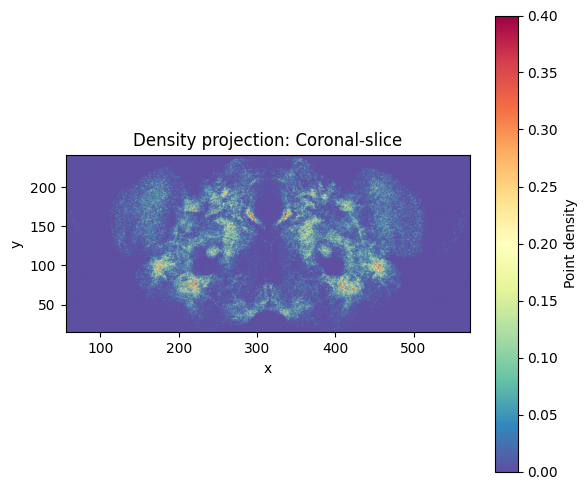

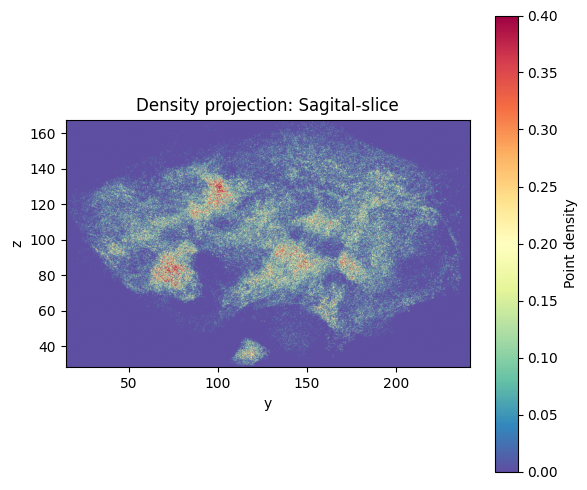

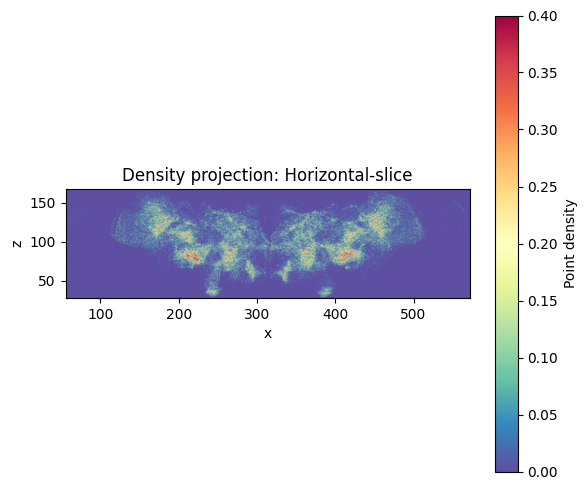

In [ ]:
def project_density(points, axis='z', bins=100, range=None, plot=False):
    """
    Projects 3D points onto a 2D plane by averaging along one axis and computes a 2D density heatmap.

    Parameters:
    - points: np.ndarray of shape (N, 3)
    - axis: str, one of 'x', 'y', or 'z' indicating the axis to average over
    - bins: int or [int, int], number of bins in each spatial dimension
    - range: list of 2-tuples or None, bin edges for the histogram
    - plot: bool, whether to plot the heatmap using matplotlib

    Returns:
    - H: 2D array of counts (density values)
    - xedges, yedges: bin edges in the 2D plane
    """

    axis = axis.lower()
    assert axis in ('x', 'y', 'z'), "Axis must be one of 'x', 'y', or 'z'"

    axis_map = {'x': (1, 2), 'y': (0, 2), 'z': (0, 1)}
    i, j = axis_map[axis]
    proj_points = points[:, [i, j]]

    # Compute 2D histogram (density)
    H, xedges, yedges = np.histogram2d(proj_points[:, 0], proj_points[:, 1],
                                       bins=bins, range=range)
    return H, xedges, yedges, i, j
    
def plot_2d_hist(H, xedges, yedges, i='x',j='y', axis='z', title='Some', normalize_H=True, zscore=False, vmax=0.3):
    if normalize_H:
        H = (H-np.min(H))/(np.max(H)-np.min(H))
    plt.figure(figsize=(6, 5))
    plt.imshow(H.T, origin='lower', aspect='equal',
                extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]],
                vmin=0, cmap='Spectral_r', vmax=vmax)
    plt.colorbar(label='Point density')
    plt.xlabel(['x', 'y', 'z'][i])
    plt.ylabel(['x', 'y', 'z'][j])
    plt.title(f'Density projection: {title}-slice')
    plt.show()

H, xedges, yedges, i, j = project_density(fru_dendrites, axis='z', bins=1000, plot=True)
plot_2d_hist(H, xedges, yedges, i=i, j=j, title='Coronal', normalize_H=True, zscore=False, vmax=0.4)
H, xedges, yedges, i, j = project_density(fru_dendrites, axis='x', bins=1000, plot=True)
plot_2d_hist(H, xedges, yedges, i=i, j=j, title='Sagital', normalize_H=True, zscore=False, vmax=0.4)
H, xedges, yedges, i, j = project_density(fru_dendrites, axis='y', bins=1000, plot=True)
plot_2d_hist(H, xedges, yedges, i=i, j=j, title='Horizontal', normalize_H=True, zscore=False, vmax=0.4)

In [78]:
from sklearn.cluster import KMeans

In [80]:
kmeans_model = KMeans(n_clusters=20)
kmeans_model.fit(fru_dendrites)

KMeans(n_clusters=20)

In [101]:
colors = [
    '#1f77b4',  # muted blue
    '#ff7f0e',  # orange
    '#2ca02c',  # green
    '#d62728',  # red
    '#9467bd',  # purple
    '#8c564b',  # brown
    '#e377c2',  # pink
    '#7f7f7f',  # gray
    '#bcbd22',  # yellow-green
    '#17becf',  # cyan
    '#393b79',  # dark blue
    '#637939',  # olive green
    '#8c6d31',  # dark orange
    '#843c39',  # dark red
    '#7b4173',  # dark purple
    '#3182bd',  # steel blue
    '#e6550d',  # rust orange
    '#31a354',  # forest green
    '#756bb1',  # medium purple
    '#636363'   # dark gray
    ]

colors_list = []
for i in kmeans_model.labels_:
    colors_list.append(colors[i])

In [103]:
import plotly.graph_objects as go
def interactive_plot(x,y,z, color_list=None):
    # Create interactive plot
    if color_list == None:
        fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='markers', 
                                        marker=dict(size=2, color=z, opacity =0.5, colorscale='Viridis'))])
    else:
        fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='markers', 
                                        marker=dict(size=2, color=color_list, opacity =0.5, colorscale='Viridis'))])
    fig.update_layout(title="Interactive 3D Scatter Plot", margin=dict(l=0, r=0, b=0, t=40))

    fig.show()
interactive_plot(x,y,z, color_list=colors_list)